<a href="https://colab.research.google.com/github/shadowbd/Airline_delay_/blob/main/Modeling_major_option_2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [44]:
import warnings
warnings.filterwarnings('ignore')

import pandas as pd
import numpy as np

#import sklearn
from sklearn.preprocessing import OneHotEncoder
from sklearn.linear_model import Ridge, LinearRegression, ElasticNet, Lasso
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import MinMaxScaler

from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_absolute_error
from xgboost import XGBRegressor
import matplotlib.pyplot as plt

# displaying all the columns and row throughout the notebook
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

In [45]:
from google.colab import files
uploaded = files.upload()

Saving cargurus_eda_major_option_2.csv to cargurus_eda_major_option_2 (2).csv


In [46]:
df = pd.read_csv('cargurus_eda_major_option_2.csv')
df.head(1)

,brand,mileage,age,transmission,color,drivetrain,fuel type,engine-hp,engine-l,engine-type,location,no_of_features,price,Bluetooth,Alloy Wheels,Backup Camera,Remote Start,Heated Seats,Android Auto,CarPlay,Sport Package,Leather Seats,Sunroof/Moonroof,Navigation System,Multi Zone Climate Control,nan,Blind Spot Monitoring,Parking Sensors,Adaptive Cruise Control,Chrome Wheels,Quick Order Package,Off Road Package,Third Row Seating,Premium Package,Steel Wheels,Cold Weather Package,M Sport Package,RS Package,Adaptive Suspension,Technology Package,Convenience Package,Tow Package,Audio Package,Trim Package,DVD Entertainment System,Heat Package,Power Package,Comfort Package,LE Package,SLE Package,Premium Wheels,Appearance Package,SR5 Package,Driver Assistance Package,Memory Package,Limited Package,LT Package,Premium Sound Package,Sound Package,Customer Preferred Package,Preferred Package,Cargo Package,Suspension Package,Sport Chrono Package,Premium Plus Package,Trailer Package,Executive Package,SE Package,LS Package,Luxury Package,Ambient Light Package,Ultra Luxury Package,Safety Package,Value Package,Z71 Package,Premium 1 Package,Light Package,AMG Sport Package,Multimedia Package,Smoker Package,Premium Audio Package,Bi Xenon Headlamp Package,Ultimate Package,SL Package,5th Wheel,Preferred Equipment Package,Security Package,Standard Suspension Package,XLE Package,Performance Package,Lariat Package,502A Luxury Equipment Group,302A Luxury Equipment Group,XLT Package,Power Mirror Package,Z 71 Package,Carbon Ceramic Brakes,TRD Package,Driver Confidence Package,2lt Package,301A Mid Equipment Group,Special Edition Package
0,RAM,26000.0,3.0,Automatic,Blue,Four-Wheel Drive,Flex Fuel Vehicle,305.0,3.6,V6,New Westminster,7.0,38900.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1883 entries, 0 to 1882
Columns: 102 entries, brand to Special Edition Package
dtypes: float64(95), object(7)
memory usage: 1.5+ MB


In [21]:
#num_col = ['mileage', 'age', 'engine-hp', 'engine-l', 'price', 'no_of_features]

In [47]:
Categorial_col = ['brand', 'transmission', 'color', 'drivetrain', 'fuel type', 'engine-type', 'location']

In [48]:
not_feature_col = ['brand', 'transmission', 'color', 'drivetrain', 'fuel type', 'engine-type', 'location', 'mileage', 'age', 'engine-hp', 'engine-l', 'price', 'no_of_features']

In [49]:
df_feature = df.drop(not_feature_col, axis=1)

In [50]:
df_feature.head(2)

,Bluetooth,Alloy Wheels,Backup Camera,Remote Start,Heated Seats,Android Auto,CarPlay,Sport Package,Leather Seats,Sunroof/Moonroof,Navigation System,Multi Zone Climate Control,nan,Blind Spot Monitoring,Parking Sensors,Adaptive Cruise Control,Chrome Wheels,Quick Order Package,Off Road Package,Third Row Seating,Premium Package,Steel Wheels,Cold Weather Package,M Sport Package,RS Package,Adaptive Suspension,Technology Package,Convenience Package,Tow Package,Audio Package,Trim Package,DVD Entertainment System,Heat Package,Power Package,Comfort Package,LE Package,SLE Package,Premium Wheels,Appearance Package,SR5 Package,Driver Assistance Package,Memory Package,Limited Package,LT Package,Premium Sound Package,Sound Package,Customer Preferred Package,Preferred Package,Cargo Package,Suspension Package,Sport Chrono Package,Premium Plus Package,Trailer Package,Executive Package,SE Package,LS Package,Luxury Package,Ambient Light Package,Ultra Luxury Package,Safety Package,Value Package,Z71 Package,Premium 1 Package,Light Package,AMG Sport Package,Multimedia Package,Smoker Package,Premium Audio Package,Bi Xenon Headlamp Package,Ultimate Package,SL Package,5th Wheel,Preferred Equipment Package,Security Package,Standard Suspension Package,XLE Package,Performance Package,Lariat Package,502A Luxury Equipment Group,302A Luxury Equipment Group,XLT Package,Power Mirror Package,Z 71 Package,Carbon Ceramic Brakes,TRD Package,Driver Confidence Package,2lt Package,301A Mid Equipment Group,Special Edition Package
0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,1.0,1.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [53]:
my_object_df = df.select_dtypes(include='object')
my_numeric_df = df.select_dtypes(exclude='object')

In [54]:
df_objects_dummies = pd.get_dummies(my_object_df, drop_first=True)


In [58]:
my_numeric_df.columns

Index(['mileage', 'age', 'engine-hp', 'engine-l', 'no_of_features', 'price',
       'Bluetooth', 'Alloy Wheels', 'Backup Camera', 'Remote Start',
       'Heated Seats', 'Android Auto', 'CarPlay', 'Sport Package',
       'Leather Seats', 'Sunroof/Moonroof', 'Navigation System',
       'Multi Zone Climate Control', 'nan', 'Blind Spot Monitoring',
       'Parking Sensors', 'Adaptive Cruise Control', 'Chrome Wheels',
       'Quick Order Package', 'Off Road Package', 'Third Row Seating',
       'Premium Package', 'Steel Wheels', 'Cold Weather Package',
       'M Sport Package', 'RS Package', 'Adaptive Suspension',
       'Technology Package', 'Convenience Package', 'Tow Package',
       'Audio Package', 'Trim Package', 'DVD Entertainment System',
       'Heat Package', 'Power Package', 'Comfort Package', 'LE Package',
       'SLE Package', 'Premium Wheels', 'Appearance Package', 'SR5 Package',
       'Driver Assistance Package', 'Memory Package', 'Limited Package',
       'LT Package', 'Pre

In [55]:
df_objects_dummies.columns

Index(['brand_Alfa', 'brand_Audi', 'brand_BMW', 'brand_Buick',
       'brand_Cadillac', 'brand_Chevrolet', 'brand_Chrysler', 'brand_Dodge',
       'brand_FIAT', 'brand_Ford', 'brand_GMC', 'brand_Genesis', 'brand_Honda',
       'brand_Hyundai', 'brand_INFINITI', 'brand_Jaguar', 'brand_Jeep',
       'brand_Kia', 'brand_Land', 'brand_Lexus', 'brand_Lincoln', 'brand_MINI',
       'brand_Maserati', 'brand_Mazda', 'brand_Mercedes-Benz',
       'brand_Mitsubishi', 'brand_Nissan', 'brand_Pontiac', 'brand_Porsche',
       'brand_RAM', 'brand_Scion', 'brand_Subaru', 'brand_Tesla',
       'brand_Toyota', 'brand_Volkswagen', 'brand_Volvo', 'brand_smart',
       'transmission_Manual', 'color_Blue', 'color_Gray', 'color_Green',
       'color_Orange', 'color_Other', 'color_Red', 'color_Silver',
       'color_White', 'drivetrain_Four-Wheel Drive',
       'drivetrain_Front-Wheel Drive', 'drivetrain_Rear-Wheel Drive',
       'fuel type_Diesel', 'fuel type_Electric', 'fuel type_Flex Fuel Vehicle',
      

In [61]:
 final_df = pd.concat([my_numeric_df, df_objects_dummies], axis =1 )

In [63]:
final_df.head(1)

,mileage,age,engine-hp,engine-l,no_of_features,price,Bluetooth,Alloy Wheels,Backup Camera,Remote Start,Heated Seats,Android Auto,CarPlay,Sport Package,Leather Seats,Sunroof/Moonroof,Navigation System,Multi Zone Climate Control,nan,Blind Spot Monitoring,Parking Sensors,Adaptive Cruise Control,Chrome Wheels,Quick Order Package,Off Road Package,Third Row Seating,Premium Package,Steel Wheels,Cold Weather Package,M Sport Package,RS Package,Adaptive Suspension,Technology Package,Convenience Package,Tow Package,Audio Package,Trim Package,DVD Entertainment System,Heat Package,Power Package,Comfort Package,LE Package,SLE Package,Premium Wheels,Appearance Package,SR5 Package,Driver Assistance Package,Memory Package,Limited Package,LT Package,Premium Sound Package,Sound Package,Customer Preferred Package,Preferred Package,Cargo Package,Suspension Package,Sport Chrono Package,Premium Plus Package,Trailer Package,Executive Package,SE Package,LS Package,Luxury Package,Ambient Light Package,Ultra Luxury Package,Safety Package,Value Package,Z71 Package,Premium 1 Package,Light Package,AMG Sport Package,Multimedia Package,Smoker Package,Premium Audio Package,Bi Xenon Headlamp Package,Ultimate Package,SL Package,5th Wheel,Preferred Equipment Package,Security Package,Standard Suspension Package,XLE Package,Performance Package,Lariat Package,502A Luxury Equipment Group,302A Luxury Equipment Group,XLT Package,Power Mirror Package,Z 71 Package,Carbon Ceramic Brakes,TRD Package,Driver Confidence Package,2lt Package,301A Mid Equipment Group,Special Edition Package,brand_Alfa,brand_Audi,brand_BMW,brand_Buick,brand_Cadillac,brand_Chevrolet,brand_Chrysler,brand_Dodge,brand_FIAT,brand_Ford,brand_GMC,brand_Genesis,brand_Honda,brand_Hyundai,brand_INFINITI,brand_Jaguar,brand_Jeep,brand_Kia,brand_Land,brand_Lexus,brand_Lincoln,brand_MINI,brand_Maserati,brand_Mazda,brand_Mercedes-Benz,brand_Mitsubishi,brand_Nissan,brand_Pontiac,brand_Porsche,brand_RAM,brand_Scion,brand_Subaru,brand_Tesla,brand_Toyota,brand_Volkswagen,brand_Volvo,brand_smart,transmission_Manual,color_Blue,color_Gray,color_Green,color_Orange,color_Other,color_Red,color_Silver,color_White,drivetrain_Four-Wheel Drive,drivetrain_Front-Wheel Drive,drivetrain_Rear-Wheel Drive,fuel type_Diesel,fuel type_Electric,fuel type_Flex Fuel Vehicle,fuel type_Gasoline,fuel type_Hybrid,engine-type_I4,engine-type_I5,engine-type_I6,engine-type_V6,engine-type_V8,location_Aldergrove,location_Burnaby,location_Chilliwack,location_Coquitlam,location_Delta,location_Duncan,location_Langley,location_Langley City,location_Maple Ridge,location_Mission,location_Nanaimo,location_New Westminster,location_North Vancouver,location_Parksville,location_Pitt Meadows,location_Port Coquitlam,location_Port Moody,location_Richmond,location_Sechelt,location_Sidney,location_Squamish,location_Surrey,location_Vancouver,location_Victoria,location_Westshore
0,26000.0,3.0,305.0,3.6,7.0,38900.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0


In [64]:
final_df.corr()['price'].sort_values()

age                            -0.601401
mileage                        -0.550374
drivetrain_Front-Wheel Drive   -0.459186
engine-type_I4                 -0.294058
transmission_Manual            -0.180827
brand_Nissan                   -0.148157
fuel type_Flex Fuel Vehicle    -0.131107
brand_Honda                    -0.124446
brand_Kia                      -0.107186
location_New Westminster       -0.098608
brand_Chevrolet                -0.089067
brand_Chrysler                 -0.088886
brand_FIAT                     -0.088017
location_Port Coquitlam        -0.080907
brand_MINI                     -0.077771
brand_Toyota                   -0.076980
brand_Hyundai                  -0.075122
location_Burnaby               -0.074365
brand_Dodge                    -0.068568
Steel Wheels                   -0.068444
fuel type_Gasoline             -0.057082
engine-type_I5                 -0.056327
DVD Entertainment System       -0.053661
brand_Scion                    -0.053125
color_Silver    

In [ ]:
# OH_encoder = OneHotEncoder(handle_unknown='ignore', sparse=False)
# encoder_fit = OH_encoder.fit_transform(df[Categorial_col])
# OH_encoder = OneHotEncoder(handle_unknown='ignore', sparse=False)
# encoder_fit = OH_encoder.fit_transform(df[Categorial_col])
# column_name = OH_encoder.get_feature_names(Categorial_col)
# OH_cols = pd.DataFrame(encoder_fit, columns=column_name)
# # One-hot encoding removed index; put it back
# OH_cols.index = df.index
# # Remove categorical columns (will replace with one-hot encoding)
# num_col = df.drop(Categorial_col, axis=1)

In [15]:
df.columns

Index(['brand', 'mileage', 'age', 'transmission', 'color', 'drivetrain',
       'fuel type', 'engine-hp', 'engine-l', 'engine-type',
       ...
       '302A Luxury Equipment Group', 'XLT Package', 'Power Mirror Package',
       'Z 71 Package', 'Carbon Ceramic Brakes', 'TRD Package',
       'Driver Confidence Package', '2lt Package', '301A Mid Equipment Group',
       'Special Edition Package'],
      dtype='object', length=102)

In [16]:
df['engine-type'].nunique()

6

In [14]:
n.dtypes

down    uint8
up      uint8
dtype: object

In [ ]:
len(OH_cols.columns)

91

In [ ]:
# y = num_col['price']

In [ ]:
# num_col.drop('price', axis=1, inplace = True)
# num_col.head()

In [ ]:
# sc=StandardScaler()

In [ ]:
# df_s = sc.fit_transform(num_col)

In [ ]:
# df_after_scaled = pd.DataFrame(df_s)

In [ ]:
num_col.columns

Index(['mileage', 'age', 'engine-hp', 'engine-l', 'no_of_features', 'price',
       'Bluetooth', 'Alloy Wheels', 'Backup Camera', 'Remote Start',
       'Heated Seats', 'Android Auto', 'CarPlay', 'Sport Package',
       'Leather Seats', 'Sunroof/Moonroof', 'Navigation System',
       'Multi Zone Climate Control', 'nan', 'Blind Spot Monitoring',
       'Parking Sensors', 'Adaptive Cruise Control', 'Chrome Wheels',
       'Quick Order Package', 'Off Road Package', 'Third Row Seating',
       'Premium Package', 'Steel Wheels', 'Cold Weather Package',
       'M Sport Package', 'RS Package', 'Adaptive Suspension',
       'Technology Package', 'Convenience Package', 'Tow Package',
       'Audio Package', 'Trim Package', 'DVD Entertainment System',
       'Heat Package', 'Power Package', 'Comfort Package', 'LE Package',
       'SLE Package', 'Premium Wheels', 'Appearance Package', 'SR5 Package',
       'Driver Assistance Package', 'Memory Package', 'Limited Package',
       'LT Package', 'Pre

In [ ]:
# df_after_scaled.columns = ['mileage', 'age', 'engine-hp', 'engine-l', 'no_of_features', 'price']
# df_after_scaled.head()

In [ ]:
OH_df = pd.concat([num_col, OH_cols], axis=1)

In [ ]:
OH_df.head()

,mileage,age,engine-hp,engine-l,no_of_features,price,Bluetooth,Alloy Wheels,Backup Camera,Remote Start,Heated Seats,Android Auto,CarPlay,Sport Package,Leather Seats,Sunroof/Moonroof,Navigation System,Multi Zone Climate Control,nan,Blind Spot Monitoring,Parking Sensors,Adaptive Cruise Control,Chrome Wheels,Quick Order Package,Off Road Package,Third Row Seating,Premium Package,Steel Wheels,Cold Weather Package,M Sport Package,RS Package,Adaptive Suspension,Technology Package,Convenience Package,Tow Package,Audio Package,Trim Package,DVD Entertainment System,Heat Package,Power Package,Comfort Package,LE Package,SLE Package,Premium Wheels,Appearance Package,SR5 Package,Driver Assistance Package,Memory Package,Limited Package,LT Package,Premium Sound Package,Sound Package,Customer Preferred Package,Preferred Package,Cargo Package,Suspension Package,Sport Chrono Package,Premium Plus Package,Trailer Package,Executive Package,SE Package,LS Package,Luxury Package,Ambient Light Package,Ultra Luxury Package,Safety Package,Value Package,Z71 Package,Premium 1 Package,Light Package,AMG Sport Package,Multimedia Package,Smoker Package,Premium Audio Package,Bi Xenon Headlamp Package,Ultimate Package,SL Package,5th Wheel,Preferred Equipment Package,Security Package,Standard Suspension Package,XLE Package,Performance Package,Lariat Package,502A Luxury Equipment Group,302A Luxury Equipment Group,XLT Package,Power Mirror Package,Z 71 Package,Carbon Ceramic Brakes,TRD Package,Driver Confidence Package,2lt Package,301A Mid Equipment Group,Special Edition Package,brand_Acura,brand_Alfa,brand_Audi,brand_BMW,brand_Buick,brand_Cadillac,brand_Chevrolet,brand_Chrysler,brand_Dodge,brand_FIAT,brand_Ford,brand_GMC,brand_Genesis,brand_Honda,brand_Hyundai,brand_INFINITI,brand_Jaguar,brand_Jeep,brand_Kia,brand_Land,brand_Lexus,brand_Lincoln,brand_MINI,brand_Maserati,brand_Mazda,brand_Mercedes-Benz,brand_Mitsubishi,brand_Nissan,brand_Pontiac,brand_Porsche,brand_RAM,brand_Scion,brand_Subaru,brand_Tesla,brand_Toyota,brand_Volkswagen,brand_Volvo,brand_smart,transmission_Automatic,transmission_Manual,color_Black,color_Blue,color_Gray,color_Green,color_Orange,color_Other,color_Red,color_Silver,color_White,drivetrain_All-Wheel Drive,drivetrain_Four-Wheel Drive,drivetrain_Front-Wheel Drive,drivetrain_Rear-Wheel Drive,fuel type_Biodiesel,fuel type_Diesel,fuel type_Electric,fuel type_Flex Fuel Vehicle,fuel type_Gasoline,fuel type_Hybrid,engine-type_I3,engine-type_I4,engine-type_I5,engine-type_I6,engine-type_V6,engine-type_V8,location_Abbotsford,location_Aldergrove,location_Burnaby,location_Chilliwack,location_Coquitlam,location_Delta,location_Duncan,location_Langley,location_Langley City,location_Maple Ridge,location_Mission,location_Nanaimo,location_New Westminster,location_North Vancouver,location_Parksville,location_Pitt Meadows,location_Port Coquitlam,location_Port Moody,location_Richmond,location_Sechelt,location_Sidney,location_Squamish,location_Surrey,location_Vancouver,location_Victoria,location_Westshore
0,26000.0,3.0,305.0,3.6,7.0,38900.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,49000.0,7.0,235.0,2.0,5.0,28900.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,

In [ ]:
y=OH_df['price']
X= OH_df.drop('price', axis = 1)

In [ ]:
X

,mileage,age,engine-hp,engine-l,no_of_features,Bluetooth,Alloy Wheels,Backup Camera,Remote Start,Heated Seats,Android Auto,CarPlay,Sport Package,Leather Seats,Sunroof/Moonroof,Navigation System,Multi Zone Climate Control,nan,Blind Spot Monitoring,Parking Sensors,Adaptive Cruise Control,Chrome Wheels,Quick Order Package,Off Road Package,Third Row Seating,Premium Package,Steel Wheels,Cold Weather Package,M Sport Package,RS Package,Adaptive Suspension,Technology Package,Convenience Package,Tow Package,Audio Package,Trim Package,DVD Entertainment System,Heat Package,Power Package,Comfort Package,LE Package,SLE Package,Premium Wheels,Appearance Package,SR5 Package,Driver Assistance Package,Memory Package,Limited Package,LT Package,Premium Sound Package,Sound Package,Customer Preferred Package,Preferred Package,Cargo Package,Suspension Package,Sport Chrono Package,Premium Plus Package,Trailer Package,Executive Package,SE Package,LS Package,Luxury Package,Ambient Light Package,Ultra Luxury Package,Safety Package,Value Package,Z71 Package,Premium 1 Package,Light Package,AMG Sport Package,Multimedia Package,Smoker Package,Premium Audio Package,Bi Xenon Headlamp Package,Ultimate Package,SL Package,5th Wheel,Preferred Equipment Package,Security Package,Standard Suspension Package,XLE Package,Performance Package,Lariat Package,502A Luxury Equipment Group,302A Luxury Equipment Group,XLT Package,Power Mirror Package,Z 71 Package,Carbon Ceramic Brakes,TRD Package,Driver Confidence Package,2lt Package,301A Mid Equipment Group,Special Edition Package,brand_Acura,brand_Alfa,brand_Audi,brand_BMW,brand_Buick,brand_Cadillac,brand_Chevrolet,brand_Chrysler,brand_Dodge,brand_FIAT,brand_Ford,brand_GMC,brand_Genesis,brand_Honda,brand_Hyundai,brand_INFINITI,brand_Jaguar,brand_Jeep,brand_Kia,brand_Land,brand_Lexus,brand_Lincoln,brand_MINI,brand_Maserati,brand_Mazda,brand_Mercedes-Benz,brand_Mitsubishi,brand_Nissan,brand_Pontiac,brand_Porsche,brand_RAM,brand_Scion,brand_Subaru,brand_Tesla,brand_Toyota,brand_Volkswagen,brand_Volvo,brand_smart,transmission_Automatic,transmission_Manual,color_Black,color_Blue,color_Gray,color_Green,color_Orange,color_Other,color_Red,color_Silver,color_White,drivetrain_All-Wheel Drive,drivetrain_Four-Wheel Drive,drivetrain_Front-Wheel Drive,drivetrain_Rear-Wheel Drive,fuel type_Biodiesel,fuel type_Diesel,fuel type_Electric,fuel type_Flex Fuel Vehicle,fuel type_Gasoline,fuel type_Hybrid,engine-type_I3,engine-type_I4,engine-type_I5,engine-type_I6,engine-type_V6,engine-type_V8,location_Abbotsford,location_Aldergrove,location_Burnaby,location_Chilliwack,location_Coquitlam,location_Delta,location_Duncan,location_Langley,location_Langley City,location_Maple Ridge,location_Mission,location_Nanaimo,location_New Westminster,location_North Vancouver,location_Parksville,location_Pitt Meadows,location_Port Coquitlam,location_Port Moody,location_Richmond,location_Sechelt,location_Sidney,location_Squamish,location_Surrey,location_Vancouver,location_Victoria,location_Westshore
0,26000.0,3.0,305.000000,3.600000,7.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,49000.0,7.0,235.000000,2.000000,5.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.

In [ ]:
X_train, X_valid, y_train, y_valid = train_test_split(X, y, test_size=0.2, random_state=0)

In [ ]:
X_train.shape

(1506, 185)

In [ ]:
lm = LinearRegression()
lm_scores = -1*cross_val_score(lm, X_train, y_train, scoring = 'neg_mean_absolute_error', cv = 5)
print("MAE score: {} and standard deviation {}".format(round(np.mean(lm_scores)), 
                                                        round(np.std(lm_scores))))

MAE score: 6622 and standard deviation 398


In [ ]:
rr = Ridge(alpha=0.01)
rr_scores = -1*cross_val_score(rr, X_train, y_train, scoring = 'neg_mean_absolute_error', cv = 5)
print("MAE score: {} and standard deviation {}".format(round(np.mean(rr_scores)), 
                                                        round(np.std(rr_scores))))

MAE score: 6615 and standard deviation 397


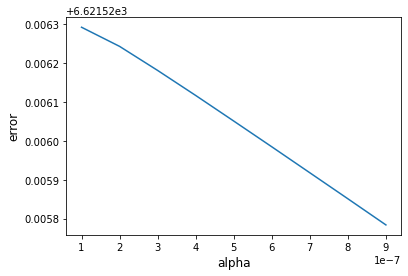

In [ ]:
#ref: https://github.com/PlayingNumbers/ds_salary_proj/blob/master/model_building.py
alpha = []
error = []

for i in range(1,10) :
    alpha.append(i/1e7)
    rr = Ridge(alpha=(i/1e7))
    error.append(np.mean(-1*cross_val_score(rr, X_train, y_train, 
                                            scoring = 'neg_mean_absolute_error')))
plt.xlabel('alpha', fontsize=12)
plt.ylabel('error', fontsize=12)
plt.plot(alpha,error);

In [ ]:
rr_min = Ridge(alpha=9e-7)
rr_min_scores = -1*cross_val_score(rr_min, X_train, y_train, 
                                   scoring = 'neg_mean_absolute_error', cv = 5)
print("MAE score: {} and standard deviation {}".format(round(np.mean(rr_min_scores)), 
                                                        round(np.std(rr_min_scores))))

MAE score: 8524 and standard deviation 261


Lasso regression


In [ ]:
ls = Lasso(alpha = 0.01)
ls_scores = -1*cross_val_score(ls, X_train, y_train, scoring = 'neg_mean_absolute_error', cv = 5)
print("MAE score: {} and standard deviation {}".format(round(np.mean(ls_scores)), 
                                                        round(np.std(ls_scores))))

MAE score: 8524 and standard deviation 261


Elastic net

In [ ]:
en = ElasticNet(alpha = 0.01)
en_scores = -1*cross_val_score(en, X_train, y_train, scoring = 'neg_mean_absolute_error', cv = 5)
print("MAE score: {} and standard deviation {}".format(round(np.mean(en_scores)), 
                                                        round(np.std(en_scores))))

MAE score: 8552 and standard deviation 215


Random Forest regression

In [ ]:
rf = RandomForestRegressor(random_state = 0)
rf_scores = -1*cross_val_score(rf, X_train, y_train, scoring = 'neg_mean_absolute_error', cv = 5)
print("MAE score: {} and standard deviation {}".format(round(np.mean(rf_scores)), 
                                                        round(np.std(rf_scores))))

MAE score: 5866 and standard deviation 256


XGBoost

In [ ]:
xg = XGBRegressor()
xg_scores = -1*cross_val_score(xg, X_train, y_train, scoring = 'neg_mean_absolute_error', cv = 5)
print("MAE score: {} and standard deviation {}".format(round(np.mean(xg_scores)), 
                                                        round(np.std(xg_scores))))

MAE score: 5807 and standard deviation 346


In [ ]:
# Hyper-Parameter Tuning

Best parameter is {'n_estimators': 150} with MAE score 5801


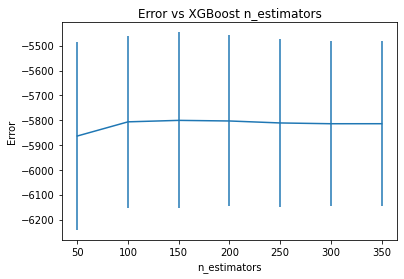

In [ ]:
n_estimators = range(50, 400, 50)
parameters = {'n_estimators': n_estimators}
gs = GridSearchCV(xg, parameters, scoring='neg_mean_absolute_error', n_jobs = -1)
gs_result=gs.fit(X_train,y_train);
# results
means = gs_result.cv_results_['mean_test_score']
stds = gs_result.cv_results_['std_test_score']
#best parameter
print('Best parameter is {} with MAE score {}'.format(gs.best_params_, round(-1*gs.best_score_)))
#Plot
plt.errorbar(n_estimators, means, yerr=stds);
plt.title("Error vs XGBoost n_estimators")
plt.xlabel('n_estimators')
plt.ylabel('Error')
plt.show()

Best parameter is {'max_depth': 6, 'n_estimators': 250} with MAE score 5811


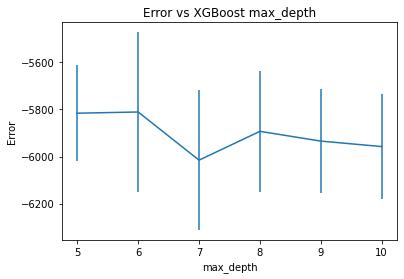

In [ ]:
max_depth=range(5,11)
parameters_1 = {'max_depth':max_depth, 'n_estimators': [250]}
gs1 = GridSearchCV(xg, param_grid = parameters_1, scoring='neg_mean_absolute_error', n_jobs = -1)
gs1_result=gs1.fit(X_train,y_train)
# results
means1 = gs1_result.cv_results_['mean_test_score']
stds1 = gs1_result.cv_results_['std_test_score']
#best parameter
print('Best parameter is {} with MAE score {}'.format(gs1.best_params_, round(-1*gs1.best_score_)))
#Plot
plt.errorbar(max_depth, means1, yerr=stds1);
plt.title("Error vs XGBoost max_depth")
plt.xlabel('max_depth')
plt.ylabel('Error')
plt.show()

In [ ]:
gs1.best_estimator_

XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, enable_categorical=False,
             gamma=0, gpu_id=-1, importance_type=None,
             interaction_constraints='', learning_rate=0.300000012,
             max_delta_step=0, max_depth=6, min_child_weight=1, missing=nan,
             monotone_constraints='()', n_estimators=250, n_jobs=8,
             num_parallel_tree=1, predictor='auto', random_state=0, reg_alpha=0,
             reg_lambda=1, scale_pos_weight=1, subsample=1, tree_method='exact',
             validate_parameters=1, verbosity=None)

In [ ]:
xgf = gs1.best_estimator_
xgf_scores = -1*cross_val_score(xgf, X_train, y_train, 
                               scoring = 'neg_mean_absolute_error', cv = 5)
print("MAE score: {} and standard deviation {}".format(round(np.mean(xgf_scores)), 
                                                        round(np.std(xgf_scores))))

MAE score: 5811 and standard deviation 338


In [ ]:
import xgboost as xgb
xg_reg = xgb.XGBRegressor(objective ='reg:linear', colsample_bytree = 0.3, learning_rate = 0.1,
                max_depth = 5, alpha = 10, n_estimators = 10)

In [ ]:
xg_reg.fit( X_train, y_train)

[19:24:15] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/objective/regression_obj.cu:188: reg:linear is now deprecated in favor of reg:squarederror.


XGBRegressor(alpha=10, base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=0.3, enable_categorical=False,
             gamma=0, gpu_id=-1, importance_type=None,
             interaction_constraints='', learning_rate=0.1, max_delta_step=0,
             max_depth=5, min_child_weight=1, missing=nan,
             monotone_constraints='()', n_estimators=10, n_jobs=8,
             num_parallel_tree=1, objective='reg:linear', predictor='auto',
             random_state=0, reg_alpha=10, reg_lambda=1, scale_pos_weight=1,
             subsample=1, tree_method='exact', validate_parameters=1,
             verbosity=None)

In [ ]:
preds = xg_reg.predict(X_valid)

In [ ]:
from sklearn.metrics import mean_absolute_error, mean_squared_error
mse = mean_squared_error(y_valid, preds)
print('MSE: %f' %(mse))

MSE: 567962720.245828


In [ ]:
rmse = np.sqrt(mean_squared_error(y_valid, preds))
print('RMSE: %f' %(rmse))

RMSE: 23831.968451


In [ ]:
from sklearn.metrics import r2_score
r2_score_xgb = r2_score(y_valid, preds)
print(r2_score_xgb)

0.06111767513509836


In [ ]:
feature_important = xg.get_booster().get_score(importance_type='weight')
keys = list(feature_important.keys())
values = list(feature_important.values())

data = pd.DataFrame(data=values, index=keys, columns=["score"]).sort_values(by = "score", ascending=False)
data[:10].plot(kind='barh');

NotFittedError: need to call fit or load_model beforehand